# S04 T01: Visualització gràfica d'un dataset

## Descripció:
Complementa les tècniques d'exploració de les dades mitjantçant la visualització gràfica, amb les llibreries Matplotlib i Searborn.

### Nivell 1
- Exercici 1
Resumeix gràficament el data set DelayedFlights.csv

Crea almenys una visualització per:

* Una variable categòrica (UniqueCarrier)
* Una variable numèrica (ArrDelay)
* Una variable numèrica i una categòrica (ArrDelay i UniqueCarrier)
* Dues variables numèriques (ArrDelay i DepDelay)
* Tres variables (ArrDelay, DepDelay i UniqueCarrier)
* Més de tres variables (ArrDelay, DepDelay, AirTime i UniqueCarrier).

In [ ]:
# Render our plots inline
%matplotlib inline
# Import matplotlib
import matplotlib.pyplot as plt
# Import numpy
import numpy as np
# Import pandas
import pandas as pd
# Import seaborn
import seaborn as sns
sns.set_theme(style="ticks", color_codes=True)
# Import plotnine
from plotnine import ggplot, aes, stat_bin, geom_bar
plt.style.use('ggplot')
#plt.style.use('default')
from matplotlib import rcParams

In [39]:
# Reading data from CSV: with CSV files a single line is needed to load the data:
#DelayedFlights_df = pd.read_csv('..\estructures_dataframe\DelayedFlights.csv', index_col=0, low_memory=False)
DelayedFlights_df = pd.read_csv('..\estructures_dataframe\DelayedFlights.csv', index_col=0) #, index_col=0, low_memory=False
#DelayedFlights_df.set_index(['Year'], inplace = True, append = False, drop = True)
# resetting index
#DelayedFlights_df.reset_index(inplace = True)
#print('Dataframe dimensions:', DelayedFlights_df.shape)
DelayedFlights_df

C:\Users\anaconda3\envs\myhpc\lib\site-packages\numpy\lib\arraysetops.py:583: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,...,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,2008,1,3,4,2003.0,1955,2211.0,2225,WN,335,...,4.0,8.0,0,N,0,NaN,NaN,NaN,NaN,NaN
1,2008,1,3,4,754.0,735,1002.0,1000,WN,3231,...,5.0,10.0,0,N,0,NaN,NaN,NaN,NaN,NaN
2,2008,1,3,4,628.0,620,804.0,750,WN,448,...,3.0,17.0,0,N,0,NaN,NaN,NaN,NaN,NaN
4,2008,1,3,4,1829.0,1755,1959.0,1925,WN,3920,...,3.0,10.0,0,N,0,2.0,0.0,0.0,0.0,32.0
5,2008,1,3,4,1940.0,1915,2121.0,2110,WN,378,...,4.0,10.0,0,N,0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7009710,2008,12,13,6,1250.0,1220,1617.0,1552,DL,1621,...,9.0,18.0,0,N,0,3.0,0.0,0.0,0.0,22.0
7009717,2008,12,13,6,657.0,600,904.0,749,DL,1631,...,15.0,34.0,0,N,0,0.0,57.0,18.0,0.0,0.0
7009718,2008,12,13,6,1007.0,847,1149.0,1010,DL,1631,...,8.0,32.0,0,N,0,1.0,0.0,19.0,0.0,79.0
7009726,2008,12,13,6,1251.0,1240,1446.0,1437,DL,1639,...,13.0,13.0,0,N,0,NaN,NaN,NaN,NaN,NaN


In [40]:
# Duplicate elimination
DelayedFlights_df.drop_duplicates(inplace=True)
# removing null values to avoid errors 
DelayedFlights_df.dropna(inplace = True)
# Selecting only flights from January 2008:
DelayedFlights_df = DelayedFlights_df[DelayedFlights_df['Month'] == 1]
DelayedFlights_df.head()

,Year,Month,DayofMonth,DayOfWeek,DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,...,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
4,2008,1,3,4,1829.0,1755,1959.0,1925,WN,3920,...,3.0,10.0,0,N,0,2.0,0.0,0.0,0.0,32.0
6,2008,1,3,4,1937.0,1830,2037.0,1940,WN,509,...,3.0,7.0,0,N,0,10.0,0.0,0.0,0.0,47.0
11,2008,1,3,4,1644.0,1510,1845.0,1725,WN,1333,...,6.0,8.0,0,N,0,8.0,0.0,0.0,0.0,72.0
16,2008,1,3,4,1452.0,1425,1640.0,1625,WN,675,...,7.0,8.0,0,N,0,3.0,0.0,0.0,0.0,12.0
18,2008,1,3,4,1323.0,1255,1526.0,1510,WN,4,...,4.0,9.0,0,N,0,0.0,0.0,0.0,0.0,16.0


In [41]:
DelayedFlights_df.columns

Index(['Year', 'Month', 'DayofMonth', 'DayOfWeek', 'DepTime', 'CRSDepTime',
       'ArrTime', 'CRSArrTime', 'UniqueCarrier', 'FlightNum', 'TailNum',
       'ActualElapsedTime', 'CRSElapsedTime', 'AirTime', 'ArrDelay',
       'DepDelay', 'Origin', 'Dest', 'Distance', 'TaxiIn', 'TaxiOut',
       'Cancelled', 'CancellationCode', 'Diverted', 'CarrierDelay',
       'WeatherDelay', 'NASDelay', 'SecurityDelay', 'LateAircraftDelay'],
      dtype='object')

In [42]:
subset_df = DelayedFlights_df[['UniqueCarrier','Month','ArrDelay','DepDelay','AirTime']]
#subset_df.set_index(['UniqueCarrier'], inplace = True, append = True, drop = True)
# resetting index
#subset_df.reset_index(inplace = True)
# let's see the DataFrame
subset_df.head()

,UniqueCarrier,Month,ArrDelay,DepDelay,AirTime
4,WN,1,34.0,34.0,77.0
6,WN,1,57.0,67.0,230.0
11,WN,1,80.0,94.0,107.0
16,WN,1,15.0,27.0,213.0
18,WN,1,16.0,28.0,110.0


In [43]:
df = subset_df.copy()
df.set_index(['UniqueCarrier'], inplace = True, append = False, drop = True)
# resetting index
df.reset_index(inplace = True)
# Add two columns to make a new column
df.loc[:,'Total_Delay'] = df.loc[:,'ArrDelay'] + df.loc[:,'DepDelay']
print('Updated DataFrame:')
print(df)

Updated DataFrame:
       UniqueCarrier  Month  ArrDelay  DepDelay  AirTime  Total_Delay
0                 WN      1      34.0      34.0     77.0         68.0
1                 WN      1      57.0      67.0    230.0        124.0
2                 WN      1      80.0      94.0    107.0        174.0
3                 WN      1      15.0      27.0    213.0         42.0
4                 WN      1      16.0      28.0    110.0         44.0
...              ...    ...       ...       ...      ...          ...
120781            DL      1      34.0      30.0    258.0         64.0
120782            DL      1     185.0     200.0    239.0        385.0
120783            DL      1      19.0      11.0    113.0         30.0
120784            DL      1      23.0       7.0    249.0         30.0
120785            DL      1     216.0     207.0     87.0        423.0

[120786 rows x 6 columns]


In [44]:
df = subset_df.copy()
# Add two columns to make a new column
df.loc[:,'Total_Delay'] = df.loc[:,['ArrDelay','DepDelay']].sum(axis=1)
print('Updated DataFrame:')
print(df)

Updated DataFrame:
       UniqueCarrier  Month  ArrDelay  DepDelay  AirTime  Total_Delay
4                 WN      1      34.0      34.0     77.0         68.0
6                 WN      1      57.0      67.0    230.0        124.0
11                WN      1      80.0      94.0    107.0        174.0
16                WN      1      15.0      27.0    213.0         42.0
18                WN      1      16.0      28.0    110.0         44.0
...              ...    ...       ...       ...      ...          ...
605627            DL      1      34.0      30.0    258.0         64.0
605641            DL      1     185.0     200.0    239.0        385.0
605657            DL      1      19.0      11.0    113.0         30.0
605699            DL      1      23.0       7.0    249.0         30.0
605733            DL      1     216.0     207.0     87.0        423.0

[120786 rows x 6 columns]


In [45]:
df['UniqueCarrier'].describe()

count     120786
unique        20
top           WN
freq       19951
Name: UniqueCarrier, dtype: object

In [46]:
df.sort_values(by=['UniqueCarrier']).groupby(['UniqueCarrier'])
df

,UniqueCarrier,Month,ArrDelay,DepDelay,AirTime,Total_Delay
4,WN,1,34.0,34.0,77.0,68.0
6,WN,1,57.0,67.0,230.0,124.0
11,WN,1,80.0,94.0,107.0,174.0
16,WN,1,15.0,27.0,213.0,42.0
18,WN,1,16.0,28.0,110.0,44.0
...,...,...,...,...,...,...
605627,DL,1,34.0,30.0,258.0,64.0
605641,DL,1,185.0,200.0,239.0,385.0
605657,DL,1,19.0,11.0,113.0,30.0
605699,DL,1,23.0,7.0,249.0,30.0


In [47]:
df.loc[:,'Count'] = df.loc[:,'UniqueCarrier'].count()
df

,UniqueCarrier,Month,ArrDelay,DepDelay,AirTime,Total_Delay,Count
4,WN,1,34.0,34.0,77.0,68.0,120786
6,WN,1,57.0,67.0,230.0,124.0,120786
11,WN,1,80.0,94.0,107.0,174.0,120786
16,WN,1,15.0,27.0,213.0,42.0,120786
18,WN,1,16.0,28.0,110.0,44.0,120786
...,...,...,...,...,...,...,...
605627,DL,1,34.0,30.0,258.0,64.0,120786
605641,DL,1,185.0,200.0,239.0,385.0,120786
605657,DL,1,19.0,11.0,113.0,30.0,120786
605699,DL,1,23.0,7.0,249.0,30.0,120786


## Distribution of total delay

The plot shows that majority of the delays are within 25 minutes,and the number decreases significantly as the duration increases.

This shows that major delays are few and if we reduce the minor delays air transport will be optimised and those delays with high values are actually outliers.

In [48]:

bins=np.arange(0,430,25) #
bins.dtype
bins = bins.astype(int)
bins

array([  0,  25,  50,  75, 100, 125, 150, 175, 200, 225, 250, 275, 300,
       325, 350, 375, 400, 425])

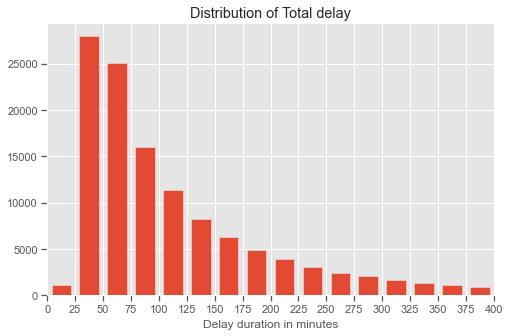

In [34]:
plt.figure(figsize=[8,5])
bins=np.arange(0,df['Total_Delay'].max()+10,25)
plt.hist(data=df,x='Total_Delay',bins=bins,rwidth=0.7)
plt.title('Distribution of Total delay')
plt.xlabel('Delay duration in minutes')
plt.xlim(0,400)
plt.xticks([0,  25,  50,  75, 100, 125, 150, 175, 200, 225, 250, 275, 300, 325, 350, 375, 400]);

## Distribution of unique carrier with total delay

From the barplot it clear that YV plane carrier has major contribution the delays followed by OO and UA.

In [49]:
#df['Counts'] = subset_df.groupby(['UniqueCarrier']).count().reset_index()
#df['Counts'] = subset_df.groupby(by="UniqueCarrier")["UniqueCarrier"].value_counts().reset_index()#name="count"
#df['Counts'] = subset_df.groupby(subset_df["UniqueCarrier"]).count().reset_index('Counts')
#df['Counts'] = subset_df.groupby('UniqueCarrier', as_index=False)['UniqueCarrier'].value_counts()
#df = df.groupby(['UniqueCarrier']).count()
type(df)
#df.sort_values(by=['UniqueCarrier'])
#df

pandas.core.frame.DataFrame

Text(0, 0.5, 'Count of Delays')

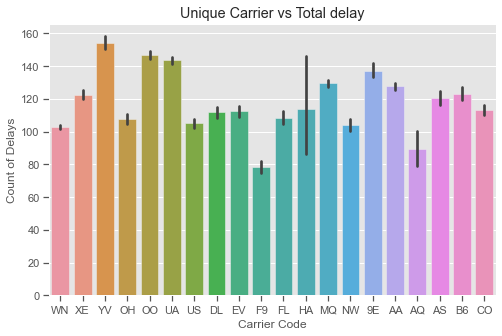

In [36]:
plt.figure(figsize=[8,5])
sns.barplot(data=df,x='UniqueCarrier',y='Total_Delay')
plt.title('Unique Carrier vs Total delay')
plt.xlabel('Carrier Code')
plt.ylabel('Count of Delays')

In [50]:
#subset_df['Count'] = subset_df['UniqueCarrier'].value_counts()#.reset_index(name="count")
#subset_df['UniqueCarrier'].value_counts().transform("count")
#subset_df = subset_df.groupby('UniqueCarrier')['UniqueCarrier']#.transform('count').copy()
#uc_df = subset_df.groupby('UniqueCarrier')#
#df = subset_df.groupby([['UniqueCarrier','Month','ArrDelay','DepDelay','AirTime']])#['UniqueCarrier'].count()
#uc_df.groups
#for uc_df, group in uc_df:
#    print(uc_df)
#    print(group.count())
#subset_df.count()
#subset_df['UniqueCarrier'].value_counts()
#subset_df = subset_df.groupby('domain')['ID'].nunique()
#subset_df = subset_df.groupby(['UniqueCarrier','Month']).size().unstack(fill_value=0)
df1=subset_df.groupby(['UniqueCarrier']).count().reset_index('UniqueCarrier')
df1
#pd_df = pd.DataFrame()
#df1.count()
#subset_df['UniqueCarrier'].value_counts()
# sort df by Total_Delay column
#df['Count'].value_count()
#df = df.sort_values('Total_Delay', ascending=False)#.reset_index(drop=True)
#df1

,UniqueCarrier,Month,ArrDelay,DepDelay,AirTime
0,9E,4728,4728,4728,4728
1,AA,13032,13032,13032,13032
2,AQ,230,230,230,230
3,AS,2421,2421,2421,2421
4,B6,2727,2727,2727,2727
5,CO,4519,4519,4519,4519
6,DL,4777,4777,4777,4777
7,EV,4901,4901,4901,4901
8,F9,1486,1486,1486,1486
9,FL,3000,3000,3000,3000


## Barplot for distribution of unique carrier with total on monthly basis

The graph shows that most of the delays in the month of October and November are of flights belonging to PS. Only in the month of December CO carrier has the majority of delays.The result seems quite obvious as seen above that PS flight carrier has the major contribution in the total delay followed by CO carrier.

Also one interesting fact that the out of the three months Month 11 i.e. November has the most number of delays.

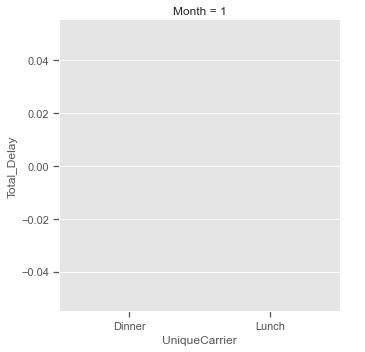

In [51]:
g = sns.FacetGrid(data=df, col='Month', margin_titles=True, sharex=False, sharey=False, height=5)
g.map(sns.barplot, 'UniqueCarrier', 'Total_Delay', order=["Dinner", "Lunch"])
g.add_legend()

In [52]:
pd_df = pd.DataFrame()
pd_df["Count"] = subset_df[['UniqueCarrier']].value_counts(sort=True)
#pd_df["Count"] = subset_df[['UniqueCarrier']].value_counts()
# resetting index
#pd_df.reset_index(inplace = True)
#pd_df.set_index(["Count"], inplace = True, append = False, drop = True)
#type(pd_df)
# sort df by Count column
#pd_df = pd_df.sort_values('Count', ascending=False)#.reset_index(drop=True)
pd_df #.to_markdown()

,Count
UniqueCarrier,
WN,19951
AA,13032
OO,11814
UA,10861
MQ,10422
XE,6969
NW,5442
US,5376
EV,4901


In [53]:
plt.figure(figsize=(12,8))
sns.barplot(data=pd_df, x="UniqueCarrier", y="Count", order=pd_df['UniqueCarrier'])

KeyError: 'UniqueCarrier'

In [54]:
plt.figure(figsize=(12,8))
# plot barh chart with index as x values
ax = sns.barplot(data=pd_df, x="UniqueCarrier", y="Count")
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
ax.set(xlabel="IATA Code", ylabel='Count')
# add proper Dim values as x labels
ax.set_xticklabels(pd_df.UniqueCarrier)
for item in ax.get_xticklabels(): item.set_rotation(90)
for i, v in enumerate(pd_df["Count"].iteritems()):        
    ax.text(i ,v[1], "{:,}".format(v[1]), color='m', va ='bottom', rotation=45)
plt.tight_layout()
plt.show()

ValueError: Could not interpret input 'UniqueCarrier'

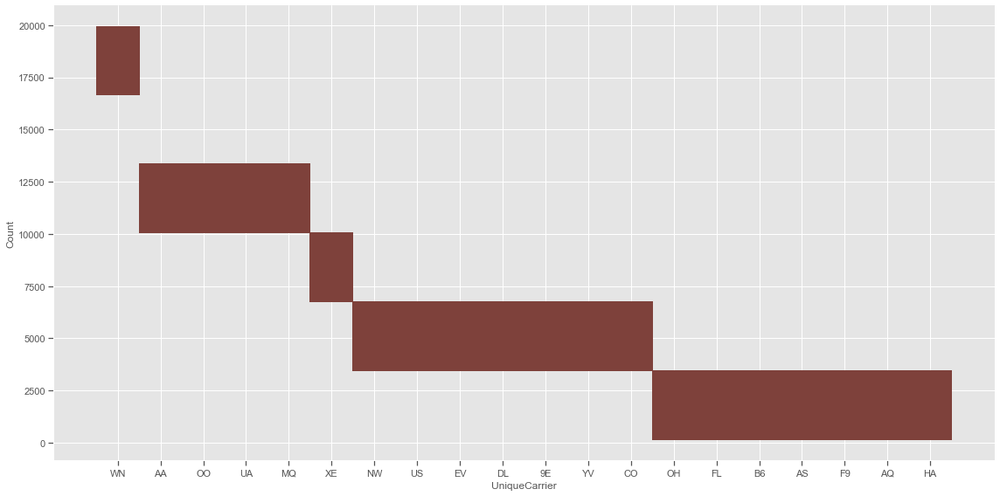

In [55]:
sns.displot(data=pd_df, x="UniqueCarrier", y="Count", kind="hist", height=8, aspect=2)#binwidth=5, shrink=.8, discrete=True

## UNIQUE CARRIER CODE

In [56]:
subset_df['UniqueCarrier'].describe()

count     120786
unique        20
top           WN
freq       19951
Name: UniqueCarrier, dtype: object

In [57]:
subset_df['UniqueCarrier'].value_counts().head(20)

WN    19951
AA    13032
OO    11814
UA    10861
MQ    10422
XE     6969
NW     5442
US     5376
EV     4901
DL     4777
9E     4728
YV     4624
CO     4519
OH     3364
FL     3000
B6     2727
AS     2421
F9     1486
AQ      230
HA      142
Name: UniqueCarrier, dtype: int64

In [58]:
subset_df['Month']

4         1
6         1
11        1
16        1
18        1
         ..
605627    1
605641    1
605657    1
605699    1
605733    1
Name: Month, Length: 120786, dtype: int64

### Convert Month int (value variable) to Month name (categorical variable)

Since the abbreviated month names is the first three letters of their full names, we could first convert the Month column to datetime and then use dt.month_name() to get the full month name and finally use str.slice() method to get the first three letters, all using pandas and only in one line of code:

In [59]:
#look_up = {'01': 'Jan', '02': 'Feb', '03': 'Mar', '04': 'Apr', '05': 'May', '06': 'Jun', '07': 'Jul', '08': 'Aug', '09': 'Sep', '10': 'Oct', '11': 'Nov', '12': 'Dec'}
#subset_df['Month_name'] = subset_df['Month'].apply(lambda x: look_up[x])
subset_df['Month_name'] = pd.to_datetime(subset_df['Month'], format='%m').dt.month_name().str.slice(stop=3)
subset_df

C:\Users\anaconda3\envs\myhpc\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,UniqueCarrier,Month,ArrDelay,DepDelay,AirTime,Month_name
4,WN,1,34.0,34.0,77.0,Jan
6,WN,1,57.0,67.0,230.0,Jan
11,WN,1,80.0,94.0,107.0,Jan
16,WN,1,15.0,27.0,213.0,Jan
18,WN,1,16.0,28.0,110.0,Jan
...,...,...,...,...,...,...
605627,DL,1,34.0,30.0,258.0,Jan
605641,DL,1,185.0,200.0,239.0,Jan
605657,DL,1,19.0,11.0,113.0,Jan
605699,DL,1,23.0,7.0,249.0,Jan


In [60]:
# Month in string format
df = pd.DataFrame({'client':['sss', 'yyy', 'www'], 'Month': ['02', '12', '06']})
look_up = {'01': 'Jan', '02': 'Feb', '03': 'Mar', '04': 'Apr', '05': 'May', '06': 'Jun', '07': 'Jul', '08': 'Aug', '09': 'Sep', '10': 'Oct', '11': 'Nov', '12': 'Dec'}
#df['Month_name'] = df['Month'].apply(lambda x: look_up[x])
df['Month_name'] = pd.to_datetime(df['Month'], format='%m').dt.month_name().str.slice(stop=3)
df

,client,Month,Month_name
0,sss,02,Feb
1,yyy,12,Dec
2,www,06,Jun


In [61]:
#rng = pd.date_range(pd.Timestamp("2018-03-10 09:00"), periods=3, freq='s')
rng = pd.Timestamp("2018-03-10 09:00")
#type(rng)
#rng.strftime('%B %d, %Y, %r')
#rng.strftime('%b')
rng.month_name()

'March'

In [62]:
import datetime

#x = datetime.datetime(2020, 5, 17)
x = datetime.datetime.now()

print(x.year)
print(x.strftime("%A"))

print(type(x))


2021
Tuesday
<class 'datetime.datetime'>


In [63]:
# Month in string format
df = pd.DataFrame({'client':['sss', 'yyy', 'www'], 'Month': ['02', '12', '06']})
def mapper(month):
   return month.strftime('%b')
df['Month_name'] = pd.to_datetime(df['Month'], format='%m').apply(mapper)
df

,client,Month,Month_name
0,sss,02,Feb
1,yyy,12,Dec
2,www,06,Jun


In [64]:
# Month in integer format
df = pd.DataFrame({'client':['sss', 'yyy', 'www'], 'Month': [2, 12, 6]})
def mapper(month):
    date = datetime.datetime(2000, month, 1)  # You need a dateobject with the proper month
    return date.strftime('%b')  # %b returns the months abbreviation, other options [here][1]

df['Month_name'] = df['Month'].apply(mapper)
df

,client,Month,Month_name
0,sss,2,Feb
1,yyy,12,Dec
2,www,6,Jun


In [65]:
for i in range(1, 13):
    month_name = calendar.month_abbr[i]
    print(month_name)

NameError: name 'calendar' is not defined

In [66]:
s = pd.Series(['fox', 'cow', np.nan, 'dog'])
s

0    fox
1    cow
2    NaN
3    dog
dtype: object

In [67]:
s.map({'fox': 'cub', 'cow': 'calf'})

0     cub
1    calf
2     NaN
3     NaN
dtype: object

In [68]:
# It also accepts a function:
s.map('I am a {}'.format)

0    I am a fox
1    I am a cow
2    I am a nan
3    I am a dog
dtype: object

In [69]:
s.map('I am a {}'.format, na_action='ignore')

0    I am a fox
1    I am a cow
2           NaN
3    I am a dog
dtype: object

In [70]:
# Month in integer format
import calendar
df = pd.DataFrame({'client':['sss', 'yyy', 'www'], 'Month': [2, 12, 6]})
df['Month_name'] = df['Month'].apply(lambda x: calendar.month_abbr[x])
#d = dict(enumerate(calendar.month_abbr))
#df['Month_name'] = df['Month'].map(d)
df

,client,Month,Month_name
0,sss,2,Feb
1,yyy,12,Dec
2,www,6,Jun


In [71]:
import time

named_tuple = time.localtime() # get struct_time
time_string = time.strftime("%m/%d/%Y, %H:%M:%S", named_tuple)

print(time_string)

08/31/2021, 17:58:18


In [72]:
import time

time_string = "21 June, 2018"
result = time.strptime(time_string, "%d %B, %Y").tm_mon
month = calendar.month_abbr[result]
print(month)
print(result)

Jun
6


In [74]:
from time import strptime
# Month in string format
df = pd.DataFrame({'client':['sss', 'yyy', 'www'], 'Month': ['02', '12', '06']})
#df['Month_name'] = df['Month'].apply(lambda x: strptime(x,'%m').tm_mon)
res = df['Month'].apply(lambda x: strptime(x,'%m').tm_mon)
df['Month_name'] = res.map(d)
df

NameError: name 'd' is not defined

In [75]:
index = ['Firefox', 'Chrome', 'Safari', 'IE10', 'Konqueror']
df = pd.DataFrame({'http_status': [200, 200, 404, 404, 301],
                  'response_time': [0.04, 0.02, 0.07, 0.08, 1.0]},
                  index=index)
df

,http_status,response_time
Firefox,200,0.04
Chrome,200,0.02
Safari,404,0.07
IE10,404,0.08
Konqueror,301,1.00


In [76]:
new_index = ['Safari', 'Iceweasel', 'Comodo Dragon', 'IE10',
             'Chrome']
#df.reindex(new_index)
df.reindex(columns=['response_time', 'http_status'])

,response_time,http_status
Firefox,0.04,200
Chrome,0.02,200
Safari,0.07,404
IE10,0.08,404
Konqueror,1.00,301


In [77]:
from numpy import random
index = [1, 2, 3, 4]
index2 = [4, 3, 2, 1, 0]
index3 = ['a','b','c','d']
index4 = ['b','a','d','c']
date2 = pd.date_range('2017-01-06', periods=4, freq='M')
value2 = np.arange(10000, 50000, 10000)
value3 = random.randint(100000, size=(4))
data  =  [['2017-01-06', 37353],
         ['2019-01-06', 94108],
         ['2019-01-05', np.nan],
         ['2019-01-04', 94514]] # Matrix
d = {'date': ['2017-01-06', '2019-01-06','2019-01-05','2019-01-04'],
     'value':[37353, 94108, np.nan, 94514]} # python dictionary
#df = pd.DataFrame(data=d, index=index)
#df.reset_index()
#df1 = df.reindex(index2, method='bfill', fill_value=0)#, method='bfill', fill_value='missing', fill_value=0
#df1 = df.reindex(columns=['value', 'date'])
#df.reindex(['value', 'date'], axis = "columns")
#df = pd.DataFrame(data=data, columns=['date','value'], index=index3, dtype=None, copy=False)
df = pd.DataFrame(data=data, columns=['date','value'], index=index, dtype=None, copy=False)
#df.set_index('date', inplace = True)
#print(df.index)

df['year'] = pd.DatetimeIndex(df['date']).year
df['month_numb'] = pd.DatetimeIndex(df['date']).month
df['month_name'] = pd.DatetimeIndex(df['date']).month_name()

#df.index = pd.to_datetime(df.index)
#year = df.index.year
#month_num = df.index.month
#month_name = df.index.month_name()
#print(year)
#print(month_num)
#print(month_name)
#print(date2)
#print(value2)
#print(value3)
print(df)
#print(df1)

         date    value  year  month_numb month_name
1  2017-01-06  37353.0  2017           1    January
2  2019-01-06  94108.0  2019           1    January
3  2019-01-05      NaN  2019           1    January
4  2019-01-04  94514.0  2019           1    January


In [78]:
# The Month_name column is a categorical variable
subset_df['Month_name'].describe(datetime_is_numeric=False)

count     120786
unique         1
top          Jan
freq      120786
Name: Month_name, dtype: object

Text(-8.449999999999996, 0.5, 'January flight count')

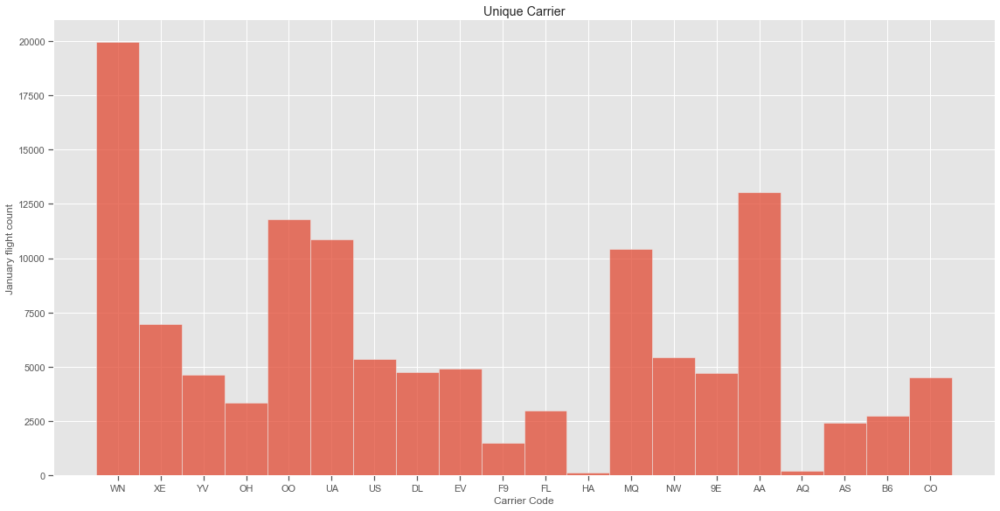

In [79]:
# figure size in inches
#rcParams['figure.figsize'] = (14, 14)
#plt.rcParams['figure.figsize'] = (14, 14)
#plt.figure(figsize=[14,14])
#sns.set(rc={'figure.figsize':(14, 14)})
sns.displot(data=subset_df, x="UniqueCarrier", binwidth=3, height=8, aspect=2)#binwidth=5, shrink=.8, discrete=True
plt.title('Unique Carrier')
plt.xlabel('Carrier Code')
plt.ylabel('January flight count')

Text(-8.449999999999996, 0.5, 'Arrival Delay count')

<Figure size 720x720 with 0 Axes>

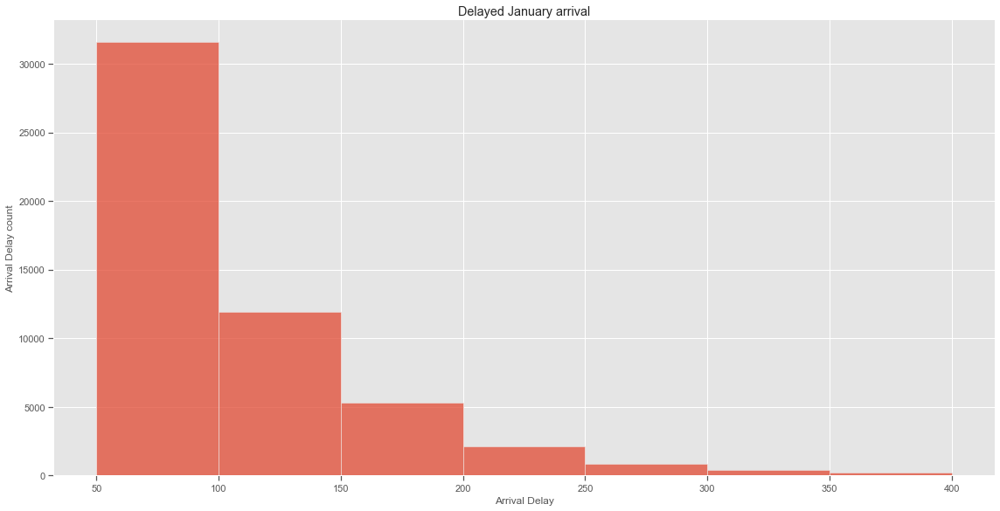

In [80]:
plt.figure(figsize=[10,10])
sns.displot(data=subset_df, x="ArrDelay", bins=[50, 100, 150, 200, 250, 300, 350, 400], height=8, aspect=2)# , binwidth=5, bins=10, bins=[100, 200, 300, 400, 500, 600, 700], discrete=True, shrink=.8
plt.title('Delayed January arrival')
plt.xlabel('Arrival Delay')
plt.ylabel('Arrival Delay count')

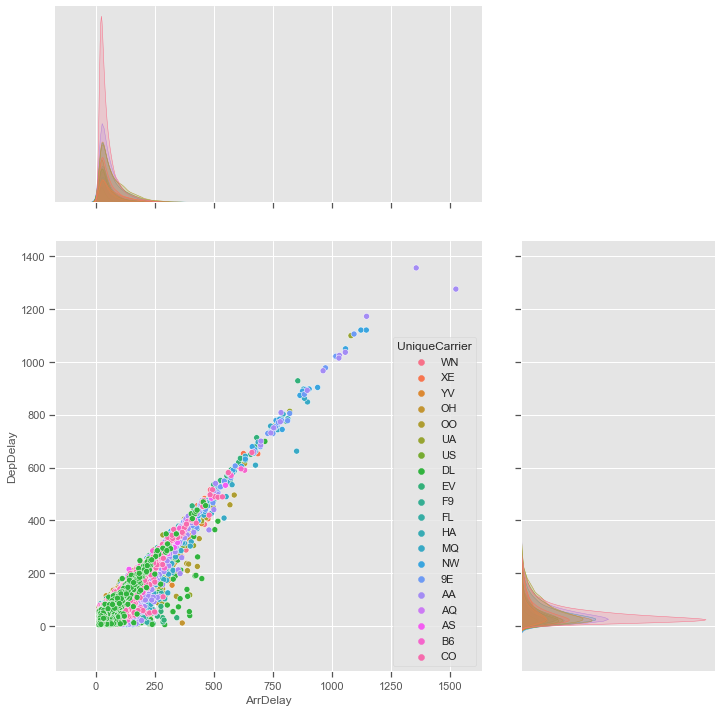

In [81]:
#plt.figure(figsize=[8,5])
#, binwidth=5, bins=10, bins=[100, 200, 300, 400, 500, 600, 700], discrete=True, shrink=.8
#sns.displot(data=subset_df, x="ArrDelay", y='DepDelay', height=8, aspect=2)
sns.jointplot(data=subset_df, x="ArrDelay", y="DepDelay", hue="UniqueCarrier", height=10, ratio=2)
#plt.title('Arrival vs Departure Delay')
#plt.xlabel('Arrival Delay')
#plt.ylabel('Departure Delay')

Text(0, 0.5, 'Arrival Delays (Min)')

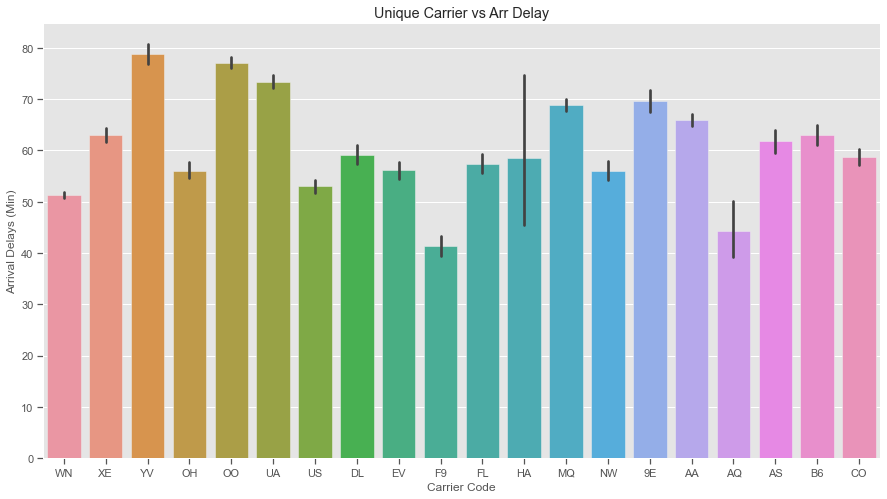

In [82]:
plt.figure(figsize=(15,8))
sns.barplot(data=subset_df,x='UniqueCarrier',y='ArrDelay')
plt.title('Unique Carrier vs Arr Delay')
plt.xlabel('Carrier Code')
plt.ylabel('Arrival Delays (Min)')


- Exercici 2
Exporta els gràfics com imatges o com html.

- Exercici 3
Integra les visualitzacions gràfiques, en la tasca 5, del Sprint 3.